<a href="https://colab.research.google.com/github/sasikirankarri/myfirst/blob/master/Unilever_Brand_Prediction_RetinaNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8MB 26kB/s 
     |████████████████████████████████| 6.6MB 3.9MB/s 
  Found existing installation: torch 1.7.0+cu101
    Uninstalling torch-1.7.0+cu101:
      Successfully uninstalled torch-1.7.0+cu101
  Found existing installation: torchvision 0.8.1+cu101
    Uninstalling torchvision-0.8.1+cu101:
      Successfully uninstalled torchvision-0.8.1+cu101
     |████████████████████████████████| 276kB 24.0MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44075 sha256=2bce3c5648ed12c4ba031677482819f2edef69f938c103c9d4823346d981f011
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip

In [2]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2MB 650kB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201122-cp36-none-any.whl size=44456 sha256=2a40ddd973b2fd5115de62452b9ea8a1b8ceb06a2d8d643a073960f4f80bc521
  Stored in directory: /root/.cache/pip/wheels/33/7b/ec/59dffd0a0aa995739aad60ac97e70252247e9d17eae69c1cee
Successfully built fvcore


In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [4]:
!curl -L "https://app.roboflow.com/ds/dJeqhQWzxV?key=FFVRhXrUqX" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   1195      0 --:--:-- --:--:-- --:--:--  1193
100 59.6M  100 59.6M    0     0  44.2M      0  0:00:01  0:00:01 --:--:--  374M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/IMG-20201103-WA0007_jpg.rf.8a6ecaa00804d6846b4173c71018a668.jpg  
 extracting: test/IMG-20201103-WA0017_jpg.rf.e0786478f117cbb041181287949d225f.jpg  
 extracting: test/IMG-20201103-WA0027_jpg.rf.32447d5d9bf659850b4a00cff029c8cf.jpg  
 extracting: test/IMG-20201103-WA0030_jpg.rf.dd75ea730a0396319c0619bdd84eea64.jpg  
 extracting: test/IMG-20201103-WA0037_jpg.rf.c028e6988eb29881a272427f747023d1.jpg  
 extracting: test/IMG-20201103-WA0048_jpg.rf.3001dff31a09750d04317849237e70f2.jpg  
 extracting: test/IMG-20201103-WA0081_jpg.rf.3ed9119c773c3b4525dd95c55c92fae2.jpg  
 extracting: tes

In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [11/11 04:03:10 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/11 04:03:10 d2.data.datasets.coco]: Loaded 204 images in COCO format from /content/train/_annotations.coco.json


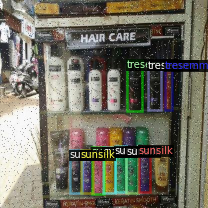

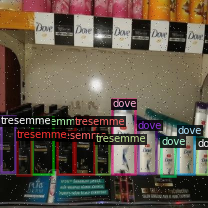

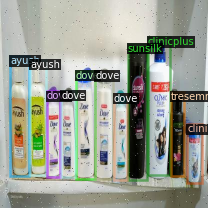

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [7]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [9]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_101_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.RETINANET.NUM_CLASSES = 23

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

Loading config /usr/local/lib/python3.6/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[11/30 11:34:10 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_59f53c.pkl: 228MB [00:10, 22.0MB/s]                           
Skip loading parameter 'head.cls_score.weight' to the model due to incompatible shapes: (720, 256, 3, 3) in the checkpoint but (207, 256, 3, 3) in the model! You might want to double check if this is expected.
Skip loading parameter 'head.cls_score.bias' to the model due to incompatible shapes: (720,) in the checkpoint but (207,) in the model! You might want to double check if this is expected.


[11/30 11:34:21 d2.engine.train_loop]: Starting training from iteration 0
[11/30 11:34:41 d2.utils.events]:  eta: 0:23:34  iter: 19  total_loss: 2.146  loss_cls: 1.733  loss_box_reg: 0.444  time: 0.9433  data_time: 0.0308  lr: 0.000020  max_mem: 10398M
[11/30 11:35:00 d2.utils.events]:  eta: 0:24:02  iter: 39  total_loss: 1.243  loss_cls: 1.007  loss_box_reg: 0.236  time: 0.9507  data_time: 0.0127  lr: 0.000040  max_mem: 10399M
[11/30 11:35:19 d2.utils.events]:  eta: 0:23:42  iter: 59  total_loss: 1.245  loss_cls: 1.004  loss_box_reg: 0.217  time: 0.9613  data_time: 0.0109  lr: 0.000060  max_mem: 10399M
[11/30 11:35:40 d2.utils.events]:  eta: 0:23:34  iter: 79  total_loss: 1.422  loss_cls: 1.163  loss_box_reg: 0.247  time: 0.9732  data_time: 0.0103  lr: 0.000080  max_mem: 10399M
[11/30 11:35:59 d2.utils.events]:  eta: 0:23:08  iter: 99  total_loss: 1.148  loss_cls: 0.918  loss_box_reg: 0.201  time: 0.9760  data_time: 0.0187  lr: 0.000100  max_mem: 10399M
[11/30 11:36:20 d2.utils.events

In [10]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [11]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.85

predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [11/30 12:06:11 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/30 12:06:11 d2.data.datasets.coco]: Loaded 45 images in COCO format from /content/test/_annotations.coco.json
[11/30 12:06:11 d2.data.build]: Distribution of instances among all 23 categories:
|  category  | #instances   |   category    | #instances   |  category  | #instances   |
|:----------:|:-------------|:-------------:|:-------------|:----------:|:-------------|
|  Shampoo   | 0            |     ayur      | 24           |   ayush    | 48           |
|    beer    | 18           |   biotique    | 23           |    chik    | 12           |
|   clear    | 46           |  clinicplus   | 173          |    dove    | 341          |
|  garnier   | 5            | headnshoulder | 189          |  himalaya  | 81           |
| indulekha  | 37           |   karthika    | 3            |  keshking  | 7            |
|   loreal   | 34           |     meera   

OrderedDict([('bbox',
              {'AP': 16.622767781397688,
               'AP-Shampoo': nan,
               'AP-ayur': 1.8844975156856343,
               'AP-ayush': 36.127659781555884,
               'AP-beer': 21.62602142648819,
               'AP-biotique': 0.40504050405040504,
               'AP-chik': 2.212656048213517,
               'AP-clear': 12.390324880471153,
               'AP-clinicplus': 45.09106685978026,
               'AP-dove': 43.970275156574246,
               'AP-garnier': 0.0,
               'AP-headnshoulder': 38.042552562017576,
               'AP-himalaya': 32.06463481414373,
               'AP-indulekha': 7.7991448874285965,
               'AP-karthika': 0.0,
               'AP-keshking': 0.0,
               'AP-loreal': 6.644895263349906,
               'AP-meera': 13.58823376705016,
               'AP-nyle': 11.816191428747159,
               'AP-pantene': 30.97615991542581,
               'AP-patanjali': 0.0,
               'AP-sunsilk': 36.65078185936

# Inference with Detectron2 Saved Weights



In [12]:
%ls ./output/

coco_instances_results.json                       last_checkpoint
events.out.tfevents.1606735886.f0bca7e19a24.55.0  metrics.json
events.out.tfevents.1606736051.f0bca7e19a24.55.1  model_final.pth
instances_predictions.pth


In [13]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

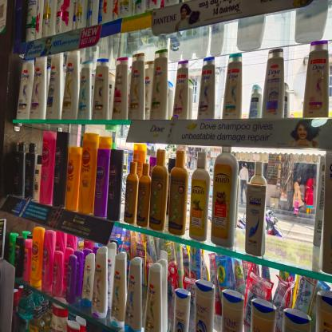

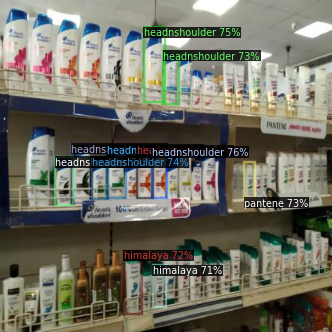

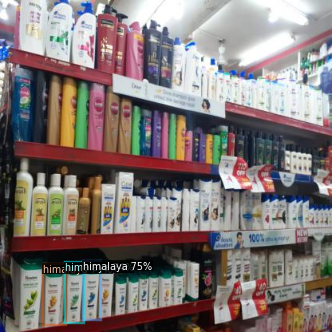

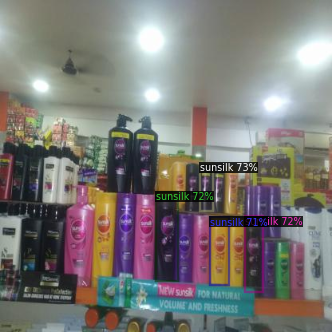

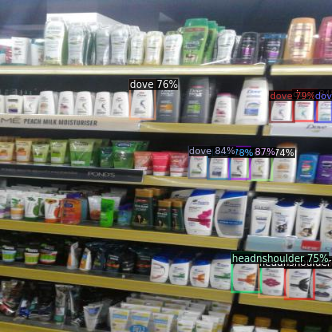

...

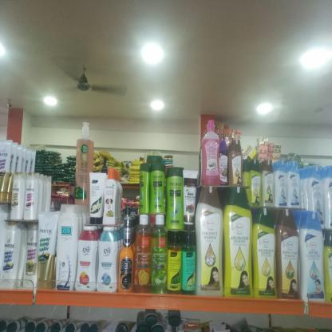

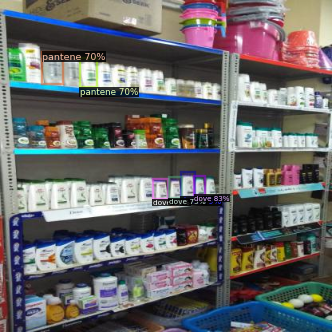

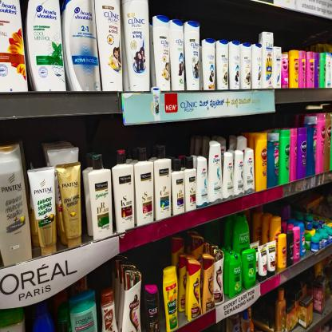

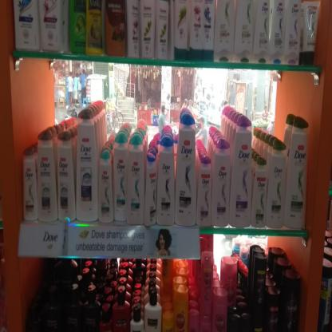

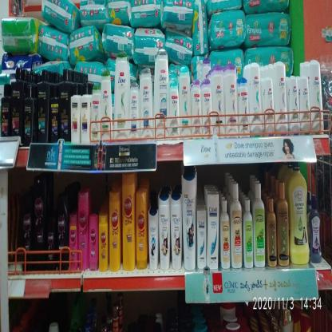

In [14]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
